### Install dependencies

In [2]:
!pip install boto3 sagemaker

Defaulting to user installation because normal site-packages is not writeable


### Setup

1. Create a new endpoint at https://us-east-2.console.aws.amazon.com/sagemaker/home?region=us-east-2#/endpoints then set `ENDPOINT` to it's name.
2. You can do inference in a single file or in a entire folder, set the path to it using `INPUT_PATH`

In [1]:
ENDPOINT = "your_endpoint_name"

# local file or folder
INPUT_PATH = "./input/artemis/"
# INPUT_PATH = "./drones.jpg"

### Run inference

Now that we have set the paths, we will run the images thuru amazon sagemaker's endpoint.

Note: This assumes you have created the endpoint and a IAM access been configured.

In [3]:
import os
import glob
import json
import boto3
import sagemaker

ALLOWED_EXTENSIONS = set(['png', 'jpg', 'jpeg', 'gif', 'webp', 'bmp'])

def getFiles(base):
    if os.path.isfile(base):
        return [base]
    else:
        return glob.glob(os.path.join(base, '**'), recursive=True)
    
# initalize client
sagemaker = boto3.client(
    'runtime.sagemaker',
    region_name='us-east-2'
)

flist = getFiles(INPUT_PATH)
print("Processing: {} files...".format(len(flist)))

for fpath in flist:
    ext = fpath.split('.')[-1].lower() if '.' in fpath else None
    
    # skip unsupported / invalid file extensions
    if ext is None or ext not in ALLOWED_EXTENSIONS:
        continue
    
    # load input
    with open(fpath, 'rb') as fh:
        payload = fh.read()

    # invoke inference
    result = sagemaker.invoke_endpoint(
            EndpointName=ENDPOINT,
            ContentType='image/{}'.format(ext),
            Body=bytearray(payload))

    # sagemaker request raw response
    # print('sagemaker response:\n\n', result, '\n')

    # inference response
    print('file: {} inference response:\n{}\n'.format(
        fpath,
        json.dumps(json.loads(result['Body'].read().decode()), sort_keys=True, indent=4))
    )

Processing: 57 files...
file: ./examples/artemis/kruger_1.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9997687935829163,
                "det_bbox": [
                    0.1588781476020813,
                    0.37882083654403687,
                    0.5109971165657043,
                    0.8648418188095093
                ],
                "label": "animal",
                "scan": "global"
            }
        ]
    }
}

file: ./examples/artemis/kruger_56.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9953600764274597,
                "det_bbox": [
                    0.21491658687591553,
                    0.4474943280220032,
                    0.632605254650116,
                    0.991271436214447
                ],
                "label": "animal",
                "scan": "gl

file: ./examples/artemis/kruger_3.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9921618103981018,
                "det_bbox": [
                    0.5274664163589478,
                    0.6275906562805176,
                    0.6381622552871704,
                    0.8397501707077026
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9396111965179443,
                "det_bbox": [
                    0.26595789194107056,
                    0.620048999786377,
                    0.38582316040992737,
                    0.84763103723526
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9191175103187561,
                "det_bbox": [
 

file: ./examples/artemis/kruger_32.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.881271481513977,
                "det_bbox": [
                    0.05041375756263733,
                    0.3344283103942871,
                    0.9979877471923828,
                    1.0
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.5792111754417419,
                "det_bbox": [
                    0.2532653510570526,
                    0.22780442237854004,
                    0.5539519786834717,
                    0.4046398997306824
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.43694791197776794,
                "det_bbox": [
            

file: ./examples/artemis/kruger_60.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9988027811050415,
                "det_bbox": [
                    0.20198911428451538,
                    0.06858035922050476,
                    0.4062700867652893,
                    0.6064324378967285
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9974654912948608,
                "det_bbox": [
                    0.48925843834877014,
                    0.2589654326438904,
                    0.7328364253044128,
                    0.566374659538269
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9971396923065186,
                "det_bbox":

file: ./examples/artemis/kruger_51.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9990519881248474,
                "det_bbox": [
                    0.048119813203811646,
                    0.009395420551300049,
                    0.8944278955459595,
                    1.0
                ],
                "label": "animal",
                "scan": "global"
            }
        ]
    }
}

file: ./examples/artemis/kruger_12.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9994551539421082,
                "det_bbox": [
                    0.4416417181491852,
                    0.34431201219558716,
                    0.6348692178726196,
                    0.7802538871765137
                ],
                "label": "animal",
                "scan": "global"
            },
            

file: ./examples/artemis/kruger_52.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.996008038520813,
                "det_bbox": [
                    0.09830829501152039,
                    0.4077727198600769,
                    0.5657476186752319,
                    0.9844575524330139
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9950116872787476,
                "det_bbox": [
                    0.719261646270752,
                    0.45468127727508545,
                    0.9143821597099304,
                    0.742638349533081
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9925673007965088,
                "det_bbox": [


file: ./examples/artemis/kruger_63.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9996820688247681,
                "det_bbox": [
                    0.2767619788646698,
                    0.21334967017173767,
                    0.6834897994995117,
                    0.8407090902328491
                ],
                "label": "animal",
                "scan": "global"
            }
        ]
    }
}

file: ./examples/artemis/kruger_58.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9997653365135193,
                "det_bbox": [
                    0.28093421459198,
                    0.2214239239692688,
                    0.682140588760376,
                    0.8647975325584412
                ],
                "label": "animal",
                "scan": "global"
            }
     

file: ./examples/artemis/kruger_18.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.979945182800293,
                "det_bbox": [
                    0.0,
                    0.3882920742034912,
                    0.07225600630044937,
                    0.49500715732574463
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9763848781585693,
                "det_bbox": [
                    0.8395925164222717,
                    0.34024593234062195,
                    0.9459383487701416,
                    0.4671858251094818
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9703090786933899,
                "det_bbox": [
            

file: ./examples/artemis/kruger_59.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.922408401966095,
                "det_bbox": [
                    0.5860310196876526,
                    0.6244590878486633,
                    0.6952717304229736,
                    0.7273975014686584
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.6551642417907715,
                "det_bbox": [
                    0.3770894706249237,
                    0.6263207197189331,
                    0.4267936050891876,
                    0.7048860788345337
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.3482753038406372,
                "det_bbox": [


file: ./examples/artemis/kruger_38.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9965948462486267,
                "det_bbox": [
                    0.32558533549308777,
                    0.4489474296569824,
                    0.4264204502105713,
                    0.6097129583358765
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9962425231933594,
                "det_bbox": [
                    0.4671310484409332,
                    0.43748390674591064,
                    0.5662691593170166,
                    0.5855894088745117
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9922588467597961,
                "det_bbox":

file: ./examples/artemis/kruger_49.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 17,
                "confidence": 0.9997555613517761,
                "det_bbox": [
                    0.47691935300827026,
                    0.33334532380104065,
                    0.6611637473106384,
                    0.7885940074920654
                ],
                "label": "animal",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.9922347068786621,
                "det_bbox": [
                    0.1808912456035614,
                    0.18047848343849182,
                    0.2571888864040375,
                    0.29671424627304077
                ],
                "label": "animal",
                "scan": "global"
            }
        ]
    }
}

file: ./examples/artemis/kruger_65.jpg inference response:
{
    "input.jpg": {
        "detections": 

file: ./examples/artemis/kruger_26.jpg inference response:
{
    "input.jpg": {
        "detections": [
            {
                "classid": 1,
                "confidence": 0.4054989814758301,
                "det_bbox": [
                    0.25025901198387146,
                    0.4145716726779938,
                    0.34869587421417236,
                    0.5762852430343628
                ],
                "label": "person",
                "scan": "global"
            },
            {
                "classid": 1,
                "confidence": 0.30761638283729553,
                "det_bbox": [
                    0.7810531258583069,
                    0.543066143989563,
                    0.8004249334335327,
                    0.6278137564659119
                ],
                "label": "person",
                "scan": "global"
            },
            {
                "classid": 17,
                "confidence": 0.6644596457481384,
                "det_bbox": [

## Run inference and draw

In this example we will draw the bounding boxes into the images

This requires OpenCV2 and matplotlib

In [2]:
%matplotlib inline

Processing: 57 files...


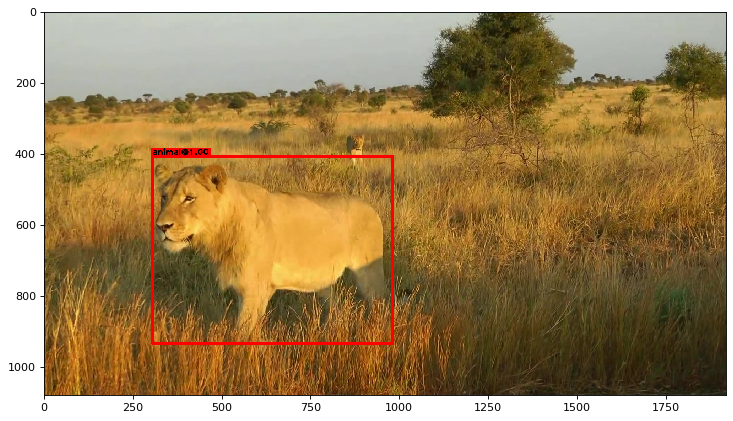

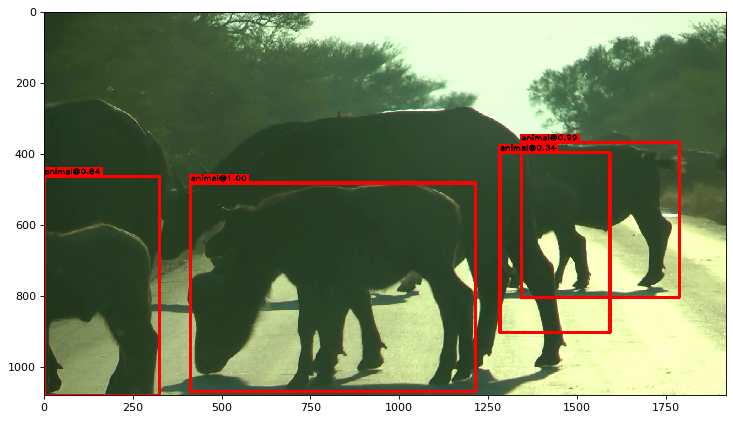

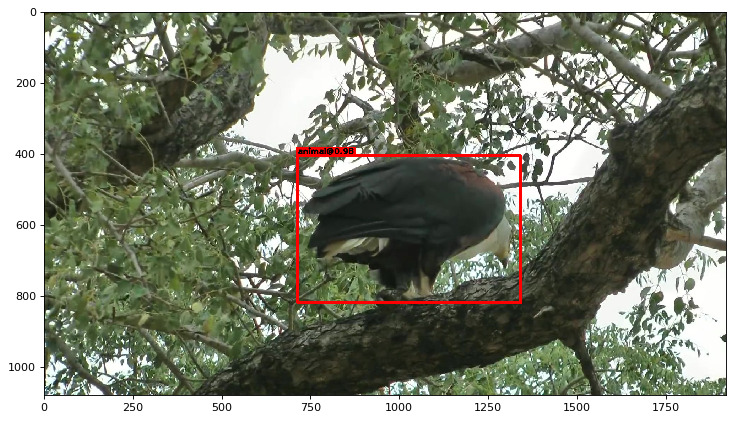

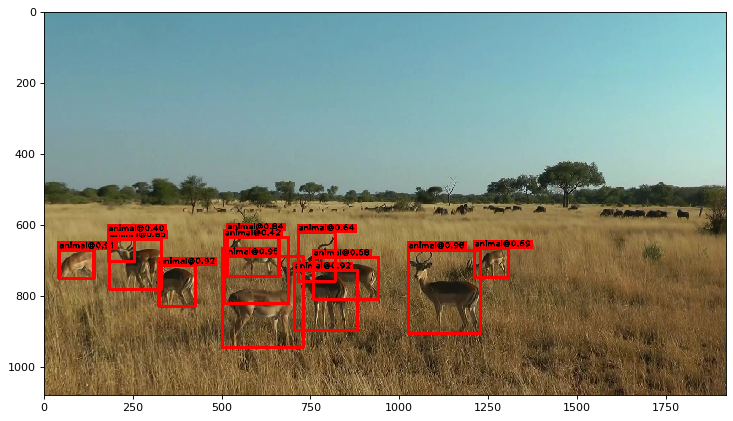

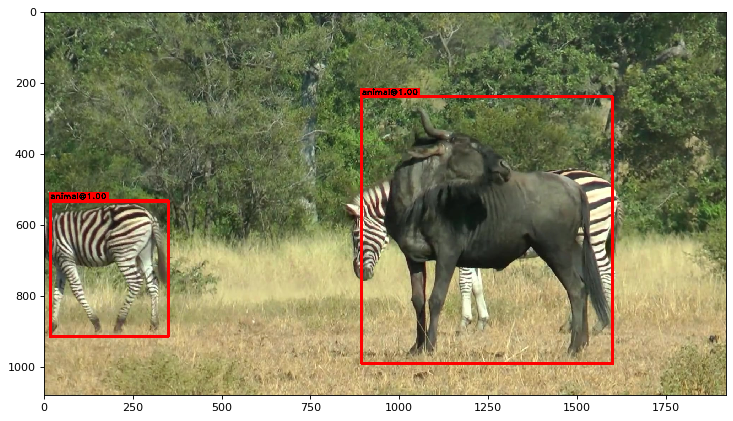

...

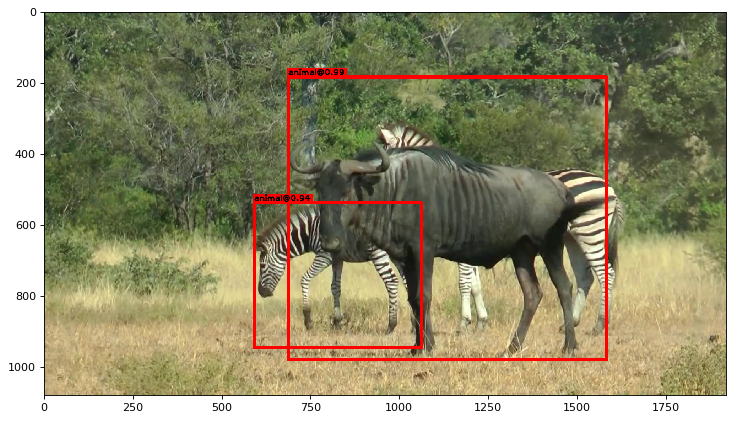

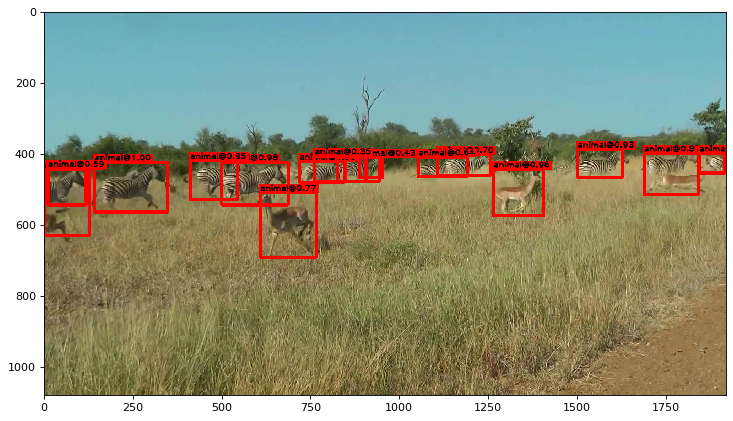

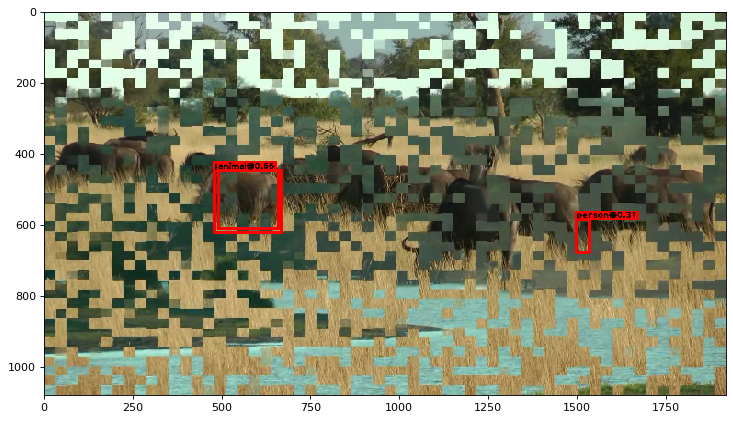

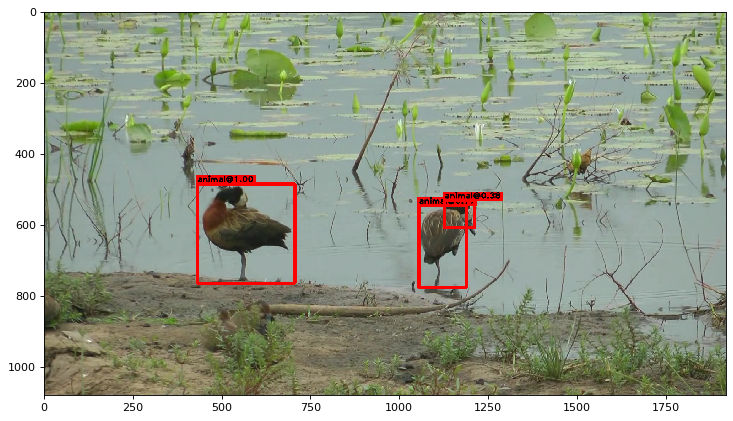

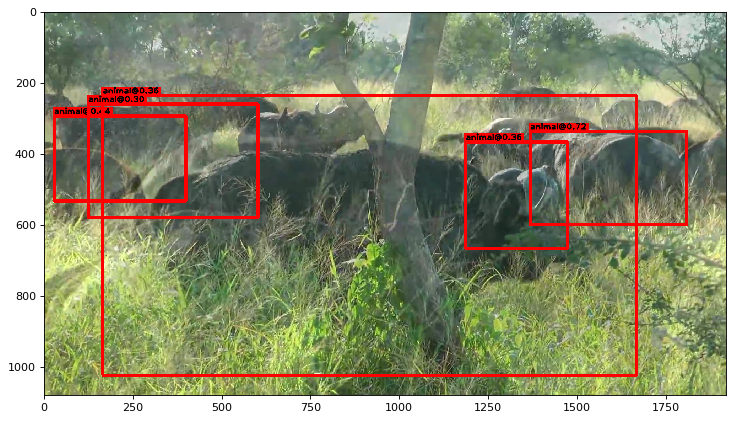

In [3]:
import os
import glob
import json
import boto3
import sagemaker
import cv2

# for displaying images at jupyter notebooks
from matplotlib import pyplot as plt

ALLOWED_EXTENSIONS = set(['png', 'jpg', 'jpeg', 'gif', 'webp', 'bmp'])

def getFiles(base):
    if os.path.isfile(base):
        return [base]
    else:
        return glob.glob(os.path.join(base, '**'), recursive=True)

def drawBB(
    image, header, x, y, xmax, ymax, color=(255, 0, 0), thickness=4*2, text_thickness=1*2,
    text_size=0.8*2, font=cv2.FONT_HERSHEY_PLAIN, footer=""
):
    # bounding box
    cv2.rectangle(image, (x, y), (xmax, ymax), color, thickness)
    
    # header text
    if header != '':
        (text_width, text_height) = cv2.getTextSize(header, font, fontScale=text_size, thickness=text_thickness)[0]
        
        cv2.rectangle(
            image,
            (max(0, int(x-(thickness/2))), max(0, int(y-5-text_height-(thickness/2)))),
            (int(x+text_width+(thickness/2)), int(y)),
            color,
            cv2.FILLED
        )
        
        cv2.putText(image, header, (max(0, x), max(0, y-5)), font, text_size, (0,0,0), text_thickness, cv2.LINE_AA)
        
    if footer != "":
        (footer_width, footer_height) = cv2.getTextSize(footer, font, fontScale=text_size, thickness=text_thickness)[0]
        
        cv2.rectangle(
            image,
            ( int(x-(thickness/2)), int(ymax+(thickness/2)) ),
            ( int(x+footer_width+(thickness/2)), int(ymax+footer_height+(thickness/2)) ),
            color,
            cv2.FILLED
        )
        
        cv2.putText(image, footer, ( x, int(ymax+12+(thickness/2)) ), font, text_size, (0,0,0), text_thickness, cv2.LINE_AA)

# initalize client
sagemaker = boto3.client(
    'runtime.sagemaker',
    region_name='us-east-2'
)

flist = getFiles(INPUT_PATH)
print("Processing: {} files...".format(len(flist)))

for fpath in flist:
    ext = fpath.split('.')[-1].lower() if '.' in fpath else None
    
    # skip unsupported / invalid file extensions
    if ext is None or ext not in ALLOWED_EXTENSIONS:
        continue
    
    # load input
    with open(fpath, 'rb') as fh:
        payload = fh.read()

    # invoke inference
    result = sagemaker.invoke_endpoint(
            EndpointName=ENDPOINT,
            ContentType='image/{}'.format(ext),
            Body=bytearray(payload))
    
    # parse response to json
    response = json.loads(result['Body'].read().decode())
    img = cv2.imread(fpath, 1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    (height, width, channels) = img.shape
    
    try:
        for det in response['input.jpg']['detections']:
            xmin = det['det_bbox'][0] * width
            ymin = det['det_bbox'][1] * height
            xmax = det['det_bbox'][2] * width
            ymax = det['det_bbox'][3] * height
            
            drawBB(img, '{}@{:.2f}'.format(det['label'], det['confidence']), int(xmin), int(ymin), int(xmax), int(ymax))
    # skip when there's no detections
    except:
        pass
    
    # show image in jupyter
    fig, ax = plt.subplots(figsize=(int(1.05 * height / 100), int(1.05 * width / 100)), dpi=80)
    ax.imshow(img, interpolation='nearest')
    plt.show()
    plt.close()
    
    # ..or just save to disk
    # cv2.imwrite('./output/artemis/{}'.format(os.path.basename(fpath)), cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    